<a href="https://colab.research.google.com/github/Patcharinee/ImageStyleTransfer/blob/main/IPadapter_style_demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Load the image encoder with CLIPVisionModelWithProjection.

In [ ]:
import torch
from diffusers import AutoPipelineForText2Image, DDIMScheduler, UniPCMultistepScheduler
from transformers import CLIPVisionModelWithProjection
from diffusers.utils import load_image, make_image_grid

image_encoder = CLIPVisionModelWithProjection.from_pretrained(
    "h94/IP-Adapter",
    subfolder="models/image_encoder",
    torch_dtype=torch.float16,
)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/560 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.53G [00:00<?, ?B/s]

Load a base model, scheduler, and the IP-Adapters.

In [ ]:
pipeline = AutoPipelineForText2Image.from_pretrained(
    "stable-diffusion-v1-5/stable-diffusion-v1-5", # base model
    torch_dtype=torch.float16,
    image_encoder=image_encoder,
)
pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)
pipeline.load_ip_adapter(
  "h94/IP-Adapter",
  subfolder="models",
  weight_name="ip-adapter-plus_sd15.bin"
)

pipeline.set_ip_adapter_scale(0.7)
pipeline.enable_model_cpu_offload()

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

ip-adapter-plus_sd15.bin:   0%|          | 0.00/158M [00:00<?, ?B/s]

Upload images that represent a style that you want the generated output image to be.

In [ ]:
!git clone https://github.com/Patcharinee/IPadapter_data.git

Cloning into 'IPadapter_data'...
remote: Enumerating objects: 33, done.
remote: Counting objects: 100% (33/33), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 33 (delta 1), reused 0 (delta 0), pack-reused 0 (from 0)
Receiving objects: 100% (33/33), 744.46 KiB | 2.40 MiB/s, done.
Resolving deltas: 100% (1/1), done.


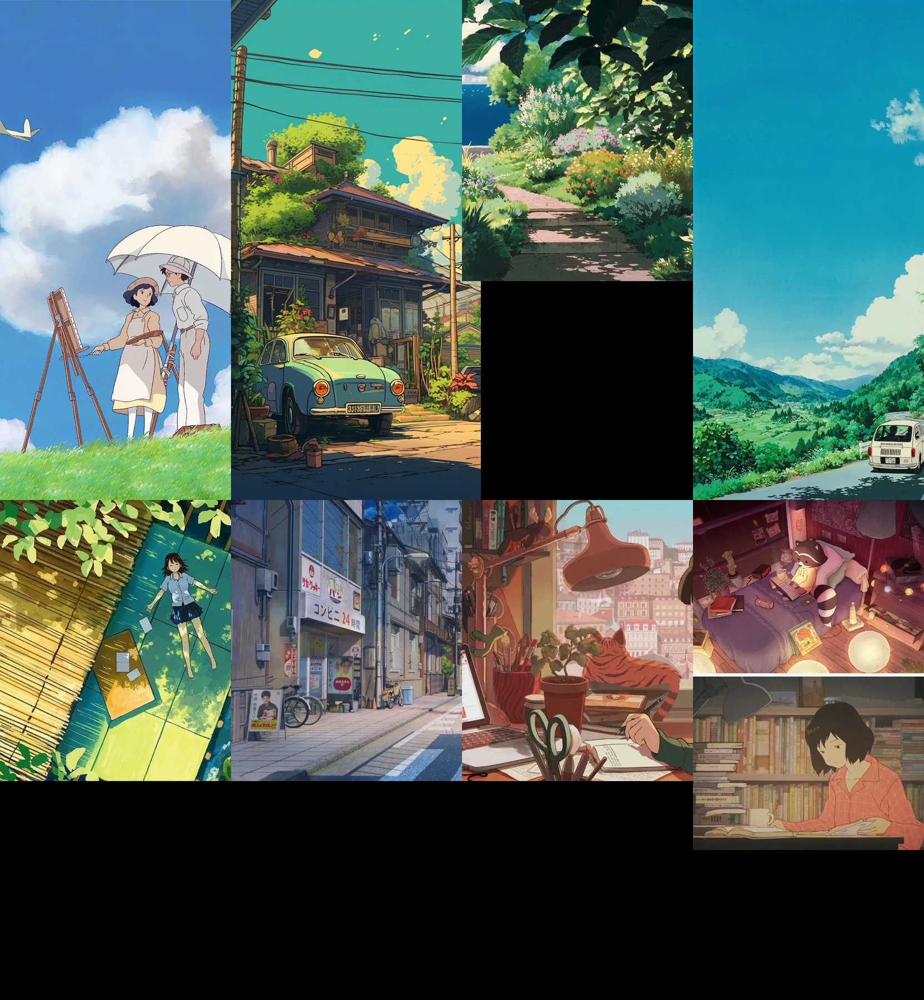

In [ ]:
style_folder = "/content/IPadapter_data/style"
style_images = [load_image(f"{style_folder}/{i+1}.webp") for i in range(8)]
make_image_grid(style_images, rows=2, cols=4)

Input text prompt, specify style images as ip_apater_image, and generate an output image.

  0%|          | 0/30 [00:00<?, ?it/s]

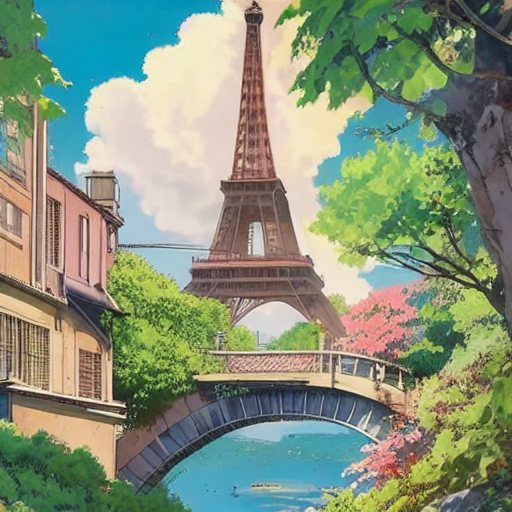

In [ ]:
#generator = torch.Generator(device="cpu").manual_seed(0)
pipeline.set_ip_adapter_scale(0.7)
image = pipeline(
    prompt="Eiffel tower in spring with Japanese cherry blossom",
    ip_adapter_image=[style_images],
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",
    num_inference_steps=30, num_images_per_prompt=1,
    #generator=generator,
).images[0]
image

In [ ]:
pipeline.set_ip_adapter_scale(0.7)
image = pipeline(
    prompt="Eiffel tower in spring with Japanese cherry blossom",
    ip_adapter_image=[style_images],
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",
    num_inference_steps=30, num_images_per_prompt=3,
    #generator=generator,
)

  0%|          | 0/30 [00:00<?, ?it/s]

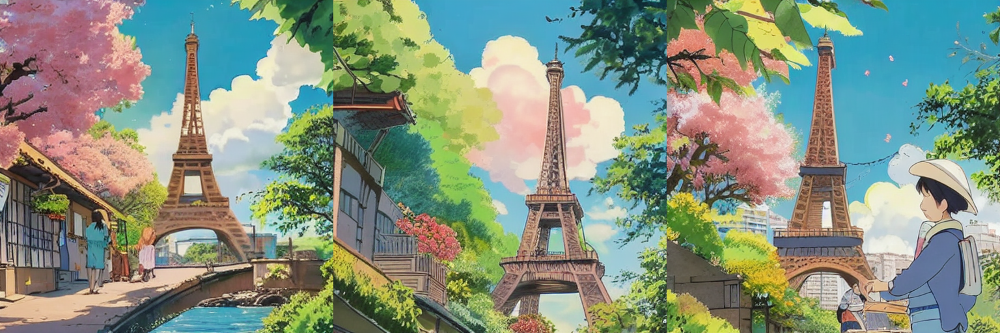

In [ ]:
make_image_grid(image[0], rows=1, cols=3)

### Try a different style (medium-shot portrait)

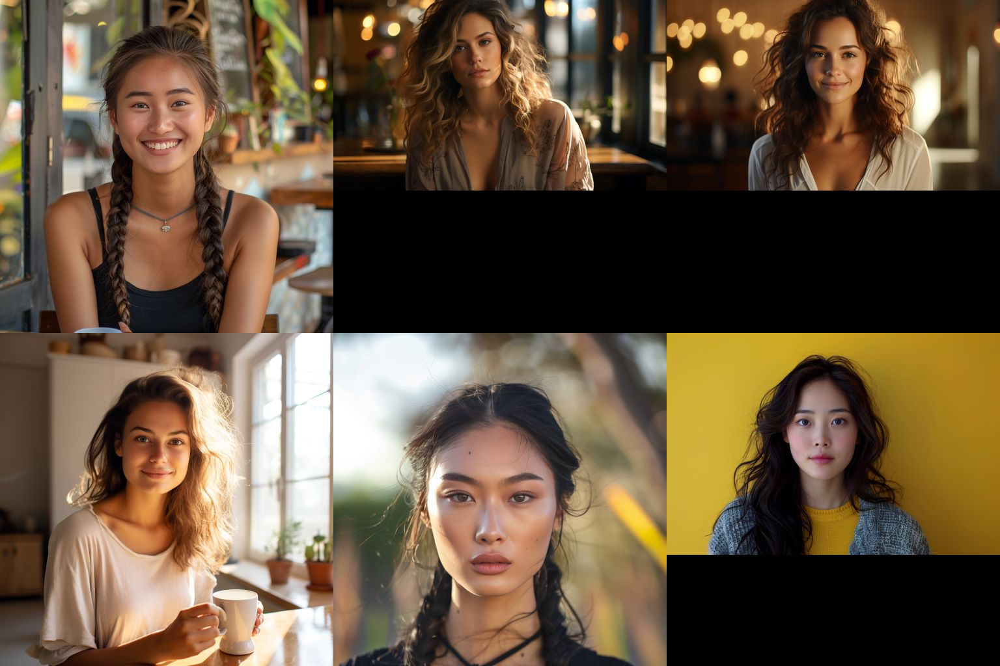

In [ ]:
style_folder = "/content/IPadapter_data/resized_medium_shot"
style_images = [load_image(f"{style_folder}/{i+1}.jpg") for i in range(6)]
make_image_grid(style_images, rows=2, cols=3)

  0%|          | 0/30 [00:00<?, ?it/s]

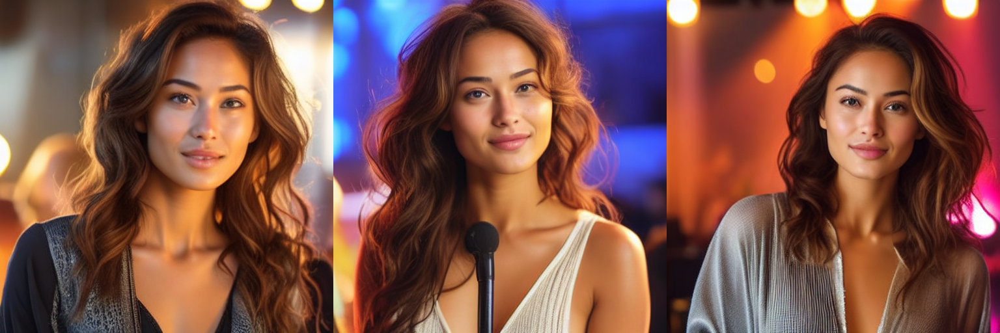

In [ ]:
pipeline.set_ip_adapter_scale(0.5)
image = pipeline(
    prompt="a pop star in a concert",
    ip_adapter_image=[style_images],
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",
    num_inference_steps=30, num_images_per_prompt=3,
    #generator=generator,
)
make_image_grid(image[0], rows=1, cols=3)

###Try different values of IP adapter scale


The set_ip_adapter_scale() method controls the amount of text or image conditioning to apply to the model. A value of 1.0 means the model is only conditioned on the image prompt. Lowering this value encourages the model to produce more diverse images, but they may not be as aligned with the image prompt. Typically, a value of 0.5 achieves a good balance between the two prompt types and produces good results.

IP adapter scale = 0.2

  0%|          | 0/30 [00:00<?, ?it/s]

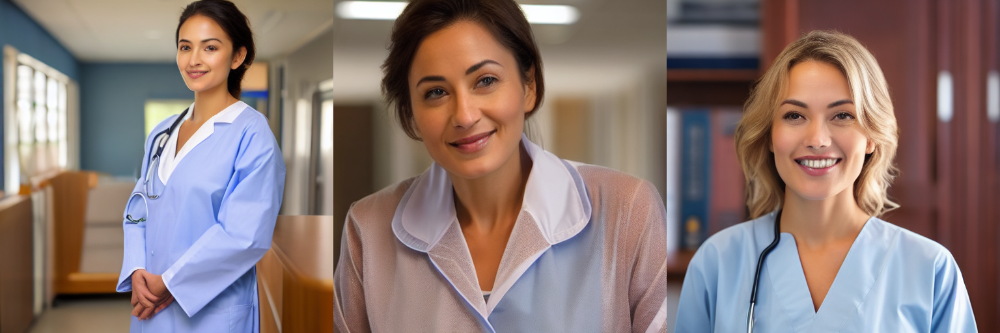

In [ ]:
pipeline.set_ip_adapter_scale(0.2)
image = pipeline(
    prompt="a doctor wearing medical gown",
    ip_adapter_image=[style_images],
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",
    num_inference_steps=30, num_images_per_prompt=3,
    #generator=generator,
)
make_image_grid(image[0], rows=1, cols=3)

IP adapter scale = 0.5

  0%|          | 0/30 [00:00<?, ?it/s]

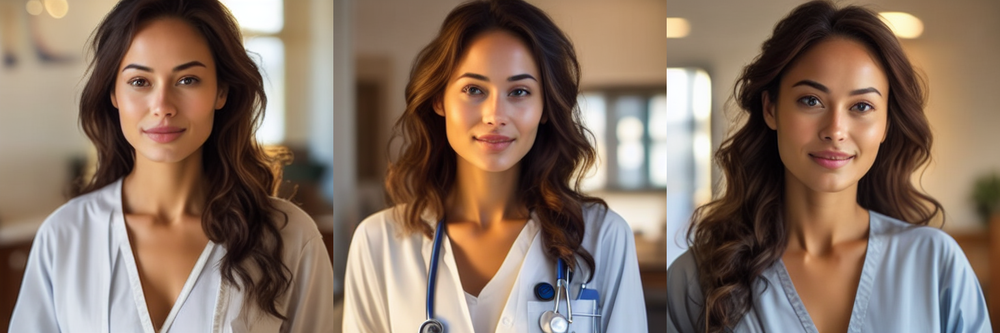

In [ ]:
pipeline.set_ip_adapter_scale(0.5)
image = pipeline(
    prompt="a doctor wearing a medical gown in a hospital",
    ip_adapter_image=[style_images],
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",
    num_inference_steps=30, num_images_per_prompt=3,
    #generator=generator,
)
make_image_grid(image[0], rows=1, cols=3)

IP adapter scale = 0.7

  0%|          | 0/30 [00:00<?, ?it/s]

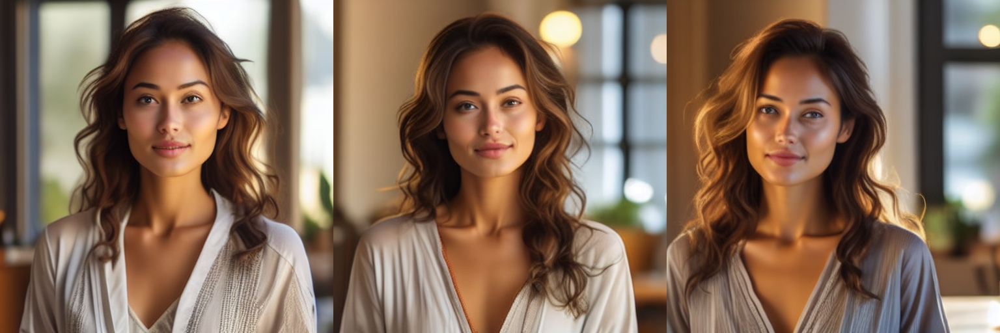

In [ ]:
pipeline.set_ip_adapter_scale(0.7)
image = pipeline(
    prompt="a doctor wearing a medical gown in a hospital",
    ip_adapter_image=[style_images],
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",
    num_inference_steps=30, num_images_per_prompt=3,
    #generator=generator,
)
make_image_grid(image[0], rows=1, cols=3)

IP adapter scale = 1.0

  0%|          | 0/30 [00:00<?, ?it/s]

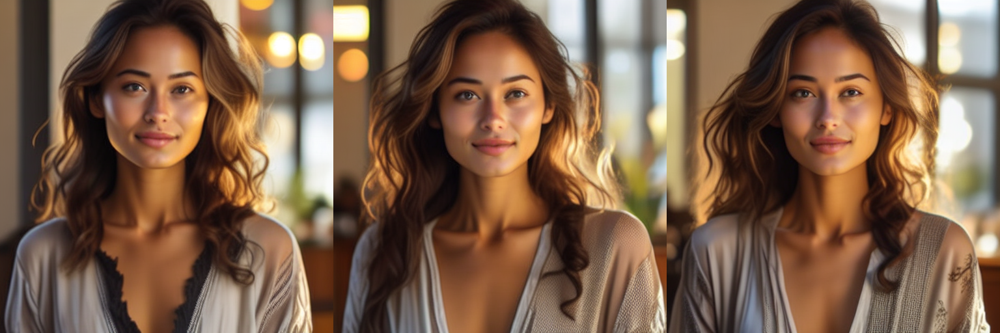

In [ ]:
pipeline.set_ip_adapter_scale(1.0)
image = pipeline(
    prompt="a doctor wearing a medical gown in a hospital",
    ip_adapter_image=[style_images],
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",
    num_inference_steps=30, num_images_per_prompt=3,
    #generator=generator,
)
make_image_grid(image[0], rows=1, cols=3)

### Try using only 2 style images and varying IP adapter scale values

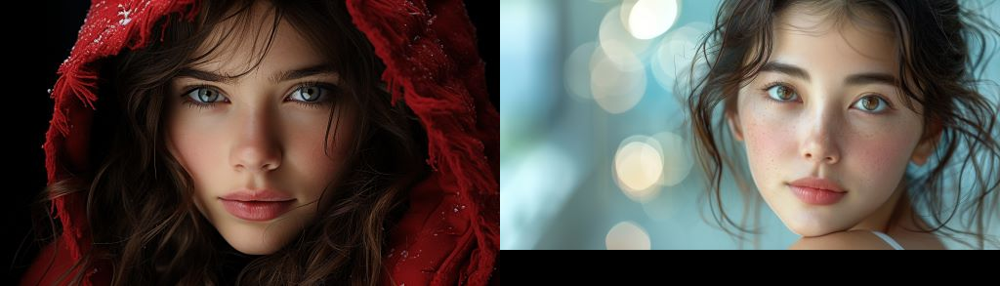

In [ ]:
style_folder = "/content/IPadapter_data/resized_close_up"
style_images = [load_image(f"{style_folder}/{i+1}.jpg") for i in range(2)]
make_image_grid(style_images, rows=1, cols=2)

IP adapter scale = 0.3

  0%|          | 0/30 [00:00<?, ?it/s]

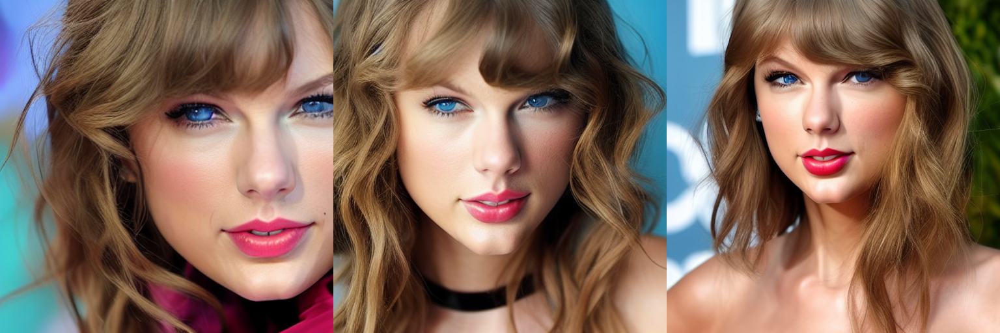

In [ ]:
pipeline.set_ip_adapter_scale(0.3)
image = pipeline(
    prompt="Taylor swift",
    ip_adapter_image=[style_images],
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",
    num_inference_steps=30, num_images_per_prompt=3,
    #generator=generator,
)
make_image_grid(image[0], rows=1, cols=3)

IP adapter scale = 0.5

  0%|          | 0/30 [00:00<?, ?it/s]

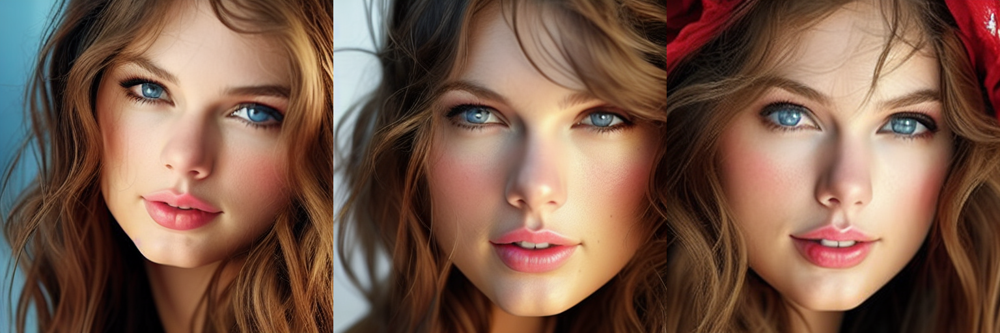

In [ ]:
pipeline.set_ip_adapter_scale(0.5)
image = pipeline(
    prompt="Taylor swift",
    ip_adapter_image=[style_images],
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",
    num_inference_steps=30, num_images_per_prompt=3,
    #generator=generator,
)
make_image_grid(image[0], rows=1, cols=3)

IP adapter scale = 0.7

  0%|          | 0/30 [00:00<?, ?it/s]

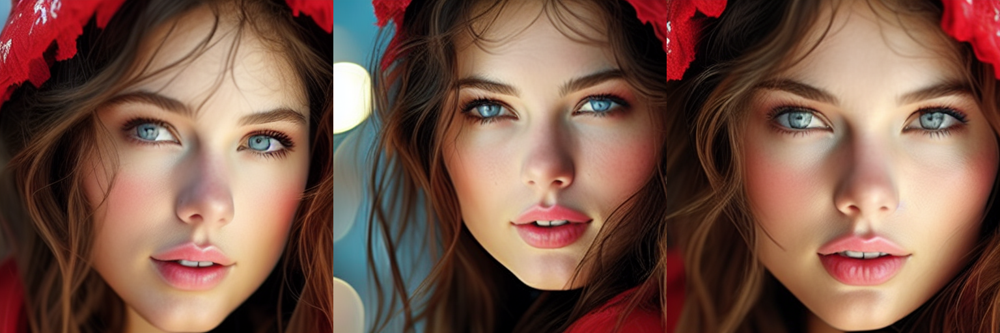

In [ ]:
pipeline.set_ip_adapter_scale(0.7)
image = pipeline(
    prompt="Taylor swift",
    ip_adapter_image=[style_images],
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",
    num_inference_steps=30, num_images_per_prompt=3,
    #generator=generator,
)
make_image_grid(image[0], rows=1, cols=3)